In [1]:
# The code was removed by Watson Studio for sharing.

In [2]:
import numpy as np # library to handle data in a vectorized manner

import pandas as pd # library for data analsysis
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

import json # library to handle JSON files

#!conda install -c conda-forge geopy --yes # uncomment this line if you haven't completed the Foursquare API lab
from geopy.geocoders import Nominatim # convert an address into latitude and longitude values

import requests # library to handle requests
from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe

#Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors

#import k-means from clustering stage
from sklearn.cluster import KMeans


print('Libraries imported.')

Libraries imported.


In [3]:
!conda install -c conda-forge folium=0.5.0 --yes 
import folium # map rendering library

Solving environment: done

## Package Plan ##

  environment location: /opt/conda/envs/Python36

  added / updated specs: 
    - folium=0.5.0


The following packages will be downloaded:

    package                    |            build
    ---------------------------|-----------------
    folium-0.5.0               |             py_0          45 KB  conda-forge
    python_abi-3.6             |          1_cp36m           4 KB  conda-forge
    altair-4.1.0               |             py_1         614 KB  conda-forge
    certifi-2020.6.20          |   py36h9f0ad1d_0         151 KB  conda-forge
    ca-certificates-2020.6.20  |       hecda079_0         145 KB  conda-forge
    branca-0.4.1               |             py_0          26 KB  conda-forge
    vincent-0.4.4              |             py_1          28 KB  conda-forge
    openssl-1.1.1g             |       h516909a_1         2.1 MB  conda-forge
    ------------------------------------------------------------
                       

In [4]:
#Reading the csv files from the object storage to pandas dataframe
myfile1.seek(0)

df_BnD = pd.read_csv(myfile1)
df_BnD.head()

,Postcode,In Use?,Latitude,Longitude,Easting,Northing,Grid Ref,Ward,Parish,Introduced,Terminated,Altitude,Country,Last Updated,Quality,LSOA Code,LSOA Name
0,IG11 0AE,Yes,51.531169,0.109388,546412,183471,TQ464834,Thames,"Barking and Dagenham, unparished area",01/07/2006,NaN,3,England,03/06/2020,Within the building of the matched address clo...,E01000096,Barking and Dagenham 022D
1,IG11 0AG,Yes,51.531241,0.106421,546206,183473,TQ462834,Thames,"Barking and Dagenham, unparished area",01/08/2006,NaN,2,England,03/06/2020,Within the building of the matched address clo...,E01000093,Barking and Dagenham 022B
2,IG11 0AH,No,51.528236,0.107998,546325,183142,TQ463831,Thames,"Barking and Dagenham, unparished area",01/12/1996,01/06/1998,2,England,03/06/2020,Postcode sector mean (mainly PO Boxes),E01000091,Barking and Dagenham 022A
3,IG11 0AJ,No,51.531459,0.107787,546300,183500,TQ463835,Thames,"Barking and Dagenham, unparished area",01/12/1997,01/06/1998,2,England,03/06/2020,Postcode terminated prior to Gridlink initiati...,E01000096,Barking and Dagenham 022D
4,IG11 0AL,No,51.534517,0.088173,544930,183801,TQ449838,Gascoigne,"Barking and Dagenham, unparished area",01/12/1998,01/08/2004,6,England,03/06/2020,Within the building of the matched address clo...,E01000052,Barking and Dagenham 019D


In [5]:
myfile2.seek(0)
df_RuT = pd.read_csv(myfile2)
df_RuT.head()

,Postcode,In Use?,Latitude,Longitude,Easting,Northing,Grid Ref,Ward,Parish,Introduced,Terminated,Altitude,Country,Last Updated,Quality,LSOA Code,LSOA Name
0,KT1 1DZ,No,51.407820,-0.309142,517700,169000,TQ176689,Hampton Wick,"Richmond upon Thames, unparished area",1990-02-01,1995-01-01,9,England,2020-06-03,Postcode terminated prior to Gridlink initiati...,E01003834,Richmond upon Thames 022A
1,KT1 2QE,No,51.412355,-0.311850,517500,169500,TQ175694,Hampton Wick,"Richmond upon Thames, unparished area",1980-01-01,1995-12-01,10,England,2020-06-03,Postcode terminated prior to Gridlink initiati...,E01003834,Richmond upon Thames 022A
2,KT1 4AA,Yes,51.409578,-0.310033,517633,169194,TQ176691,Hampton Wick,"Richmond upon Thames, unparished area",1980-01-01,NaN,9,England,2020-06-03,Within the building of the matched address clo...,E01003834,Richmond upon Thames 022A
3,KT1 4AB,Yes,51.404226,-0.309936,517654,168599,TQ176685,Hampton Wick,"Richmond upon Thames, unparished area",1980-01-01,NaN,8,England,2020-06-03,Within the building of the matched address clo...,E01003834,Richmond upon Thames 022A
4,KT1 4AD,Yes,51.399714,-0.314472,517350,168090,TQ173680,Hampton Wick,"Richmond upon Thames, unparished area",1980-01-01,NaN,6,England,2020-06-03,Within the building of the matched address clo...,E01003834,Richmond upon Thames 022A


In [6]:
myfile4.seek(0)
df_KnC = pd.read_csv(myfile4)
df_KnC.head()

,Postcode,In Use?,Latitude,Longitude,Easting,Northing,Grid Ref,Ward,Parish,Introduced,Terminated,Altitude,Country,Last Updated,Quality,LSOA Code,LSOA Name
0,SW10 0AB,Yes,51.478206,-0.183053,526275,177037,TQ262770,Chelsea Riverside,"Kensington and Chelsea, unparished area",2010-08-01,NaN,7,England,2020-06-03,Within the building of the matched address clo...,E01002841,Kensington and Chelsea 021B
1,SW10 0AD,Yes,51.485945,-0.180470,526433,177902,TQ264779,Stanley,"Kensington and Chelsea, unparished area",1980-01-01,NaN,11,England,2020-06-03,Within the building of the matched address clo...,E01002912,Kensington and Chelsea 020E
2,SW10 0AE,Yes,51.485776,-0.180621,526423,177883,TQ264778,Stanley,"Kensington and Chelsea, unparished area",1992-08-01,NaN,12,England,2020-06-03,Within the building of the matched address clo...,E01002912,Kensington and Chelsea 020E
3,SW10 0AF,Yes,51.481480,-0.183053,526266,177401,TQ262774,Stanley,"Kensington and Chelsea, unparished area",2014-05-01,NaN,9,England,2020-06-03,Within the building of the matched address clo...,E01002913,Kensington and Chelsea 021E
4,SW10 0AG,Yes,51.485807,-0.180317,526444,177887,TQ264778,Stanley,"Kensington and Chelsea, unparished area",1980-01-01,NaN,12,England,2020-06-03,Within the building of the matched address clo...,E01002912,Kensington and Chelsea 020E


In [7]:
#Cleaning up the three dataframes by removing unwanted columns
df_BnD = df_BnD[['Ward', 'Postcode', 'Latitude', 'Longitude']].copy()
df_BnD.head()


,Ward,Postcode,Latitude,Longitude
0,Thames,IG11 0AE,51.531169,0.109388
1,Thames,IG11 0AG,51.531241,0.106421
2,Thames,IG11 0AH,51.528236,0.107998
3,Thames,IG11 0AJ,51.531459,0.107787
4,Gascoigne,IG11 0AL,51.534517,0.088173


In [8]:
df_RuT = df_RuT[['Ward', 'Postcode', 'Latitude', 'Longitude']].copy()
df_RuT.head()

,Ward,Postcode,Latitude,Longitude
0,Hampton Wick,KT1 1DZ,51.407820,-0.309142
1,Hampton Wick,KT1 2QE,51.412355,-0.311850
2,Hampton Wick,KT1 4AA,51.409578,-0.310033
3,Hampton Wick,KT1 4AB,51.404226,-0.309936
4,Hampton Wick,KT1 4AD,51.399714,-0.314472


In [9]:
df_KnC = df_KnC[['Ward', 'Postcode', 'Latitude', 'Longitude']].copy()
df_KnC.head()

,Ward,Postcode,Latitude,Longitude
0,Chelsea Riverside,SW10 0AB,51.478206,-0.183053
1,Stanley,SW10 0AD,51.485945,-0.180470
2,Stanley,SW10 0AE,51.485776,-0.180621
3,Stanley,SW10 0AF,51.481480,-0.183053
4,Stanley,SW10 0AG,51.485807,-0.180317


In [10]:
#Number of wards in Barking and Dagenham
df_BnD['Ward'].nunique()


17

In [11]:
#Number of unique wards in Richmond upon Thames
df_RuT['Ward'].nunique()

18

In [12]:
#Number of unique wards in Kensington & Chelsea
df_KnC['Ward'].nunique()

18

In [13]:
from geopy.geocoders import Nominatim

address = 'Barking and Dagenham'
address1 = 'Richmond upon Thames'
address2 = 'Kensington and Chelsea'

geolocator = Nominatim(user_agent="to_explorer")
location = geolocator.geocode(address)
location1 = geolocator.geocode(address1)
location2 = geolocator.geocode(address2)

latBnD = location.latitude
longBnD = location.longitude
latRuT = location1.latitude
longRuT = location1.longitude
latKnC = location2.latitude
longKnC = location2.longitude
print('The geograpical coordinate of Barking and Dagenham are {}, {}.'.format(latBnD, longBnD), ' ', 'The geograpical coordinate of Richmond upon Thames are {}, {}.'.format(latRuT, longRuT), ' ',  
     'The geograpical coordinate of Kensington and Chelsea are {}, {}.'.format(latKnC, longKnC))

The geograpical coordinate of Barking and Dagenham are 51.5541171, 0.15050434261994267.   The geograpical coordinate of Richmond upon Thames are 51.44037225, -0.3057195504470487.   The geograpical coordinate of Kensington and Chelsea are 51.4875417, -0.1682205.


In [14]:
# creating a map of the three boroughs on London map

map_London = folium.Map(location=[51.509865, -0.118092], zoom_start=10) #Entered the coordinates of London

# add markers to map
for lat, long, postcode, ward in zip(df_BnD['Latitude'], df_BnD['Longitude'], df_BnD['Postcode'], df_BnD['Ward']):
    label = '{}, {}'.format(postcode, ward)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
       [lat, long],
       radius=5,
       popup=label,
       color='blue',
       fill=True,
       fill_color='#3186cc',
       fill_opacity=0.7,
       parse_html=False).add_to(map_London)
    

for lat, long, postcode, ward in zip(df_RuT['Latitude'], df_RuT['Longitude'], df_RuT['Postcode'], df_RuT['Ward']):
    label = '{}, {}'.format(postcode, ward)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
       [lat, long],
       radius=5,
       popup=label,
       color='red',
       fill=True,
       fill_color='#3186cc',
       fill_opacity=0.7,
       parse_html=False).add_to(map_London)
    
for lat, long, postcode, ward in zip(df_KnC['Latitude'], df_KnC['Longitude'], df_KnC['Postcode'], df_KnC['Ward']):
    label = '{}, {}'.format(postcode, ward)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
       [lat, long],
       radius=5,
       popup=label,
       color='green',
       fill=True,
       fill_color='#3186cc',
       fill_opacity=0.7,
       parse_html=False).add_to(map_London)
    
    
map_London

# Comparing the three boroughs in terms of popular venues

In [15]:
#Defining Foursquare credentials
CLIENT_ID = 'D50RCYWDFAZVXLWJZHTTFXDFUKQKMHXFQ4CGQ1Q00HK3EB5U' # your Foursquare ID
CLIENT_SECRET = 'EJ3SKOLB1COUMLPIQWCMCYNKDHNSDXUI2PYNVZW2QQXMODHM' # your Foursquare Secret
VERSION = '20180605' # Foursquare API version

print('Your credentails:')
print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET:' + CLIENT_SECRET)

Your credentails:
CLIENT_ID: D50RCYWDFAZVXLWJZHTTFXDFUKQKMHXFQ4CGQ1Q00HK3EB5U
CLIENT_SECRET:EJ3SKOLB1COUMLPIQWCMCYNKDHNSDXUI2PYNVZW2QQXMODHM


In [16]:
#Exploring the top 100 venues of Barking and Dagenham in a radius of 15000 metres
latitude = latBnD
longitude = longBnD

limit = 100
#radius = 20000
url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&limit={}'.format(
    CLIENT_ID, 
    CLIENT_SECRET, 
    VERSION, 
    latitude, 
    longitude,
    limit)
url

'https://api.foursquare.com/v2/venues/explore?&client_id=D50RCYWDFAZVXLWJZHTTFXDFUKQKMHXFQ4CGQ1Q00HK3EB5U&client_secret=EJ3SKOLB1COUMLPIQWCMCYNKDHNSDXUI2PYNVZW2QQXMODHM&v=20180605&ll=51.5541171,0.15050434261994267&limit=100'

In [21]:
#Sending GET results

results = requests.get(url).json()
results

{'meta': {'code': 200, 'requestId': '5f6307e2a61a0e5b0480ea31'},
 'response': {'suggestedFilters': {'header': 'Tap to show:',
   'filters': [{'name': 'Open now', 'key': 'openNow'}]},
  'suggestedRadius': 4956,
  'headerLocation': 'London',
  'headerFullLocation': 'London',
  'headerLocationGranularity': 'city',
  'totalResults': 92,
  'suggestedBounds': {'ne': {'lat': 51.58953694090592,
    'lng': 0.2281636190662475},
   'sw': {'lat': 51.51357316905678, 'lng': 0.072443611171455}},
  'groups': [{'type': 'Recommended Places',
    'name': 'recommended',
    'items': [{'reasons': {'count': 0,
       'items': [{'summary': 'This spot is popular',
         'type': 'general',
         'reasonName': 'globalInteractionReason'}]},
      'venue': {'id': '4ac518f8f964a520d6af20e3',
       'name': 'Central Park',
       'location': {'address': 'Wood Ln.',
        'crossStreet': 'Rainham Rd. N.',
        'lat': 51.559560186523925,
        'lng': 0.16198065419715413,
        'labeledLatLngs': [{'label

In [22]:
#This function extracts category name for each venue

def get_category_type(row):
    try:
        categories_list = row['categories']
    except:
        categories_list = row['venue.categories']
        
    if len(categories_list) == 0:
        return None
         
    else:
        return categories_list[0]['name']

In [23]:
import json
from pandas.io.json import json_normalize

bnd_venues = results['response']['groups'][0]['items']

bnd_venues = json_normalize(bnd_venues) # flatten JSON


# filter columns
filtered_columns = ['venue.name', 'venue.categories', 'venue.location.lat', 'venue.location.lng']
bnd_venues = bnd_venues.loc[:, filtered_columns]
#venues
# filter the category for each row
bnd_venues['venue.categories'] = bnd_venues.apply(get_category_type, axis=1)

# clean columns
bnd_venues.columns = [col.split(".")[-1] for col in bnd_venues.columns]

bnd_venues.head()

,name,categories,lat,lng
0,Central Park,Park,51.559560,0.161981
1,Capital Karts,Go Kart Track,51.531792,0.118739
2,Harrow Lodge Park,Park,51.555648,0.197926
3,Lara Grill,Turkish Restaurant,51.562445,0.147178
4,Costa Coffee,Coffee Shop,51.576890,0.179497


In [24]:
print('{} venues were returned by Foursquare.'.format(bnd_venues.shape[0]))


92 venues were returned by Foursquare.


In [25]:
print ('{} are the number of unique venue categories returned by Foursquare.'.format(bnd_venues['categories'].nunique()))

41 are the number of unique venue categories returned by Foursquare.


In [26]:
#Exploring the top 100 venues of Richmond upon Thames in a radius of 500 metres
latitude = latRuT
longitude = longRuT

limit = 100
#radius = 5000
url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&limit={}'.format(
    CLIENT_ID, 
    CLIENT_SECRET, 
    VERSION, 
    latitude, 
    longitude,
    limit)
url

'https://api.foursquare.com/v2/venues/explore?&client_id=D50RCYWDFAZVXLWJZHTTFXDFUKQKMHXFQ4CGQ1Q00HK3EB5U&client_secret=EJ3SKOLB1COUMLPIQWCMCYNKDHNSDXUI2PYNVZW2QQXMODHM&v=20180605&ll=51.44037225,-0.3057195504470487&limit=100'

In [27]:
#Sending GET results

results1 = requests.get(url).json()
results1

{'meta': {'code': 200, 'requestId': '5f6307f2baa7e44dd328ba5b'},
 'response': {'suggestedFilters': {'header': 'Tap to show:',
   'filters': [{'name': 'Open now', 'key': 'openNow'}]},
  'suggestedRadius': 2945,
  'headerLocation': 'London',
  'headerFullLocation': 'London',
  'headerLocationGranularity': 'city',
  'totalResults': 183,
  'suggestedBounds': {'ne': {'lat': 51.466635219253064,
    'lng': -0.2711752591695},
   'sw': {'lat': 51.41159203717842, 'lng': -0.3493342497470179}},
  'groups': [{'type': 'Recommended Places',
    'name': 'recommended',
    'items': [{'reasons': {'count': 0,
       'items': [{'summary': 'This spot is popular',
         'type': 'general',
         'reasonName': 'globalInteractionReason'}]},
      'venue': {'id': '4f6c767be4b0a235d5ac23f9',
       'name': 'Petersham Nurseries Cafe',
       'location': {'address': 'Church Ln',
        'crossStreet': 'Off Petersham Rd',
        'lat': 51.44703230425647,
        'lng': -0.3024456098270026,
        'labeledLa

In [28]:
import json
from pandas.io.json import json_normalize

rut_venues = results1['response']['groups'][0]['items']

rut_venues = json_normalize(rut_venues) # flatten JSON


# filter columns
filtered_columns = ['venue.name', 'venue.categories', 'venue.location.lat', 'venue.location.lng']
rut_venues = rut_venues.loc[:, filtered_columns]
#venues
# filter the category for each row
rut_venues['venue.categories'] = rut_venues.apply(get_category_type, axis=1)

# clean columns
rut_venues.columns = [col.split(".")[-1] for col in rut_venues.columns]

rut_venues.head()


,name,categories,lat,lng
0,Petersham Nurseries Cafe,Café,51.447032,-0.302446
1,Petersham Nurseries,Garden Center,51.447148,-0.302453
2,Pembroke Lodge,Tea Room,51.442541,-0.294486
3,Ham House & Garden,Historic Site,51.444552,-0.314525
4,Marble Hill Park,Park,51.450022,-0.312746


In [29]:
print('{} venues were returned by Foursquare.'.format(rut_venues.shape[0]))

100 venues were returned by Foursquare.


In [30]:
print ('{} are the number of unique venue categories returned by Foursquare.'.format(rut_venues['categories'].nunique()))

41 are the number of unique venue categories returned by Foursquare.


In [31]:
#Exploring the top 100 venues of Kensington and Chelsea
latitude = latKnC
longitude = longKnC

limit = 100
#radius = 5000
url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&limit={}'.format(
    CLIENT_ID, 
    CLIENT_SECRET, 
    VERSION, 
    latitude, 
    longitude,
    limit)
url

'https://api.foursquare.com/v2/venues/explore?&client_id=D50RCYWDFAZVXLWJZHTTFXDFUKQKMHXFQ4CGQ1Q00HK3EB5U&client_secret=EJ3SKOLB1COUMLPIQWCMCYNKDHNSDXUI2PYNVZW2QQXMODHM&v=20180605&ll=51.4875417,-0.1682205&limit=100'

In [32]:
#Sending GET results

results2 = requests.get(url).json()
results2

{'meta': {'code': 200, 'requestId': '5f6307ffc4904403a644dc3f'},
 'response': {'suggestedFilters': {'header': 'Tap to show:',
   'filters': [{'name': 'Open now', 'key': 'openNow'}]},
  'suggestedRadius': 1262,
  'headerLocation': 'Chelsea',
  'headerFullLocation': 'Chelsea, London',
  'headerLocationGranularity': 'neighborhood',
  'totalResults': 241,
  'suggestedBounds': {'ne': {'lat': 51.497392499736065,
    'lng': -0.1557340040155617},
   'sw': {'lat': 51.481299505542765, 'lng': -0.18162415030877255}},
  'groups': [{'type': 'Recommended Places',
    'name': 'recommended',
    'items': [{'reasons': {'count': 0,
       'items': [{'summary': 'This spot is popular',
         'type': 'general',
         'reasonName': 'globalInteractionReason'}]},
      'venue': {'id': '4ba4eb0ff964a520e9c238e3',
       'name': 'Anthropologie',
       'location': {'address': '131-141 Kings Rd',
        'lat': 51.48801219256875,
        'lng': -0.1666530953311291,
        'labeledLatLngs': [{'label': 'disp

In [33]:
knc_venues = results2['response']['groups'][0]['items']

knc_venues = json_normalize(knc_venues) # flatten JSON


# filter columns
filtered_columns = ['venue.name', 'venue.categories', 'venue.location.lat', 'venue.location.lng']
knc_venues = knc_venues.loc[:, filtered_columns]
#venues
# filter the category for each row
knc_venues['venue.categories'] = knc_venues.apply(get_category_type, axis=1)

# clean columns
knc_venues.columns = [col.split(".")[-1] for col in knc_venues.columns]

knc_venues.head()

,name,categories,lat,lng
0,Anthropologie,Women's Store,51.488012,-0.166653
1,Phật Phúc Noodle Bar,Vietnamese Restaurant,51.487620,-0.169044
2,The Ivy Chelsea Garden,English Restaurant,51.487035,-0.169379
3,Chelsea Gardener,Garden Center,51.488213,-0.169380
4,Waterstones,Bookstore,51.488829,-0.165512


In [34]:
print('{} venues were returned by Foursquare.'.format(knc_venues.shape[0]))

100 venues were returned by Foursquare.


In [35]:
print ('{} are the number of unique venue categories returned by Foursquare.'.format(knc_venues['categories'].nunique()))

57 are the number of unique venue categories returned by Foursquare.


In [36]:
# To find the number of each category of venue in a borough 

bd_venue = bnd_venues.groupby('categories')['name'].count().to_frame('Number').reset_index()
bd_venue.head()

,categories,Number
0,American Restaurant,2
1,Bakery,2
2,Bookstore,1
3,Brazilian Restaurant,1
4,Bus Stop,1


In [37]:
rt_venue=rut_venues.groupby('categories')['name'].count().to_frame('Number').reset_index()
rt_venue.head()

,categories,Number
0,Argentinian Restaurant,2
1,Art Gallery,1
2,Bakery,3
3,Beer Bar,1
4,Beer Garden,1


In [38]:
kc_venue = knc_venues.groupby('categories')['name'].count().to_frame('Number').reset_index()
kc_venue.head()

,categories,Number
0,American Restaurant,1
1,Argentinian Restaurant,1
2,Art Gallery,1
3,Art Museum,1
4,Bakery,4


In [39]:
# To understand how venue categories are distributed across the three boroughs - 

bd_venue['Borough'] = 'Barking and Dagenham'
rt_venue['Borough'] = 'Richmond upon Thames'
kc_venue['Borough'] = 'Kensington and Chelsea'

master = [bd_venue, rt_venue, kc_venue]
venue_master = pd.concat(master)
venue_master.reset_index(drop=True)
#venue_master.drop(['lat', 'lng'], axis=1, inplace=True)
#venue_master.head()
#venue_master = venue_master.groupby('categories')['Borough'].count()
#venue_master
 
    
venue_master=venue_master.pivot(index='categories', columns = 'Borough')['Number']
venue_master=venue_master.fillna(0)
venue_master

Borough,Barking and Dagenham,Kensington and Chelsea,Richmond upon Thames
categories,,,
American Restaurant,2.0,1.0,0.0
Argentinian Restaurant,0.0,1.0,2.0
Art Gallery,0.0,1.0,1.0
Art Museum,0.0,1.0,0.0
Bakery,2.0,4.0,3.0
Beer Bar,0.0,0.0,1.0
Beer Garden,0.0,0.0,1.0
Bookstore,1.0,4.0,1.0
Boxing Gym,0.0,1.0,0.0


<function matplotlib.pyplot.show(*args, **kw)>

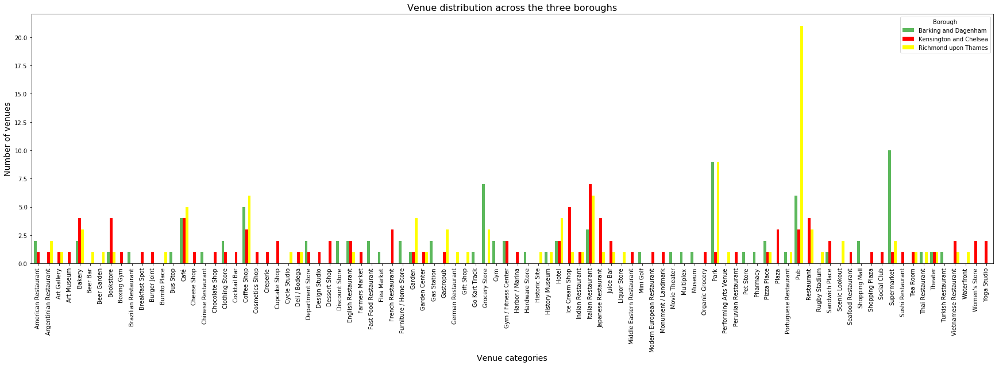

In [41]:
import matplotlib.mlab as mlab
import matplotlib.pyplot as plt

ax = venue_master [['Barking and Dagenham', 'Kensington and Chelsea', 'Richmond upon Thames']].plot(kind='bar', width=0.8, figsize=(30,8), color=['#5cb85c', 'red', 'yellow'], legend=True)
ax.set_title('Venue distribution across the three boroughs', fontsize=16) 
ax.set_xlabel('Venue categories', fontsize=14)
ax.set_ylabel('Number of venues', fontsize=14)
plt.show

# Exploring the access to open spaces for the three boroughs

## Open spaces impact a community's lifestyle - it influences physical health as well as mental health


In [18]:
myfile7.seek(0)

bnd_openspace = pd.read_csv(myfile7)
bnd_openspace.head()
bnd_openspace


,Ward,Latitude,Longitude,% homes with deficient access to nature
0,Abbey,51.537349,0.085575,2
1,Alibon,51.553493,0.141954,72
2,Becontree,51.549360,0.143736,17
3,Chadwell Heath,51.575203,0.137052,64
4,Eastbrook,51.553493,0.153209,0
5,Eastbury,51.544944,0.129347,6
6,Gascoigne,51.534517,0.088173,6
7,Goresbrook,51.539078,0.139307,8
8,Heath,51.553493,0.141954,91
9,Longbridge,51.540502,0.090788,4


In [19]:
myfile8.seek(0)

rut_openspace = pd.read_csv(myfile8)
rut_openspace.head()
rut_openspace


,Ward,Latitude,Longitude,% homes with deficient access to nature
0,Barnes,51.472674,-0.246758,0
1,East Sheen,51.454596,-0.321284,0
2,Fulwell and Hampton Hill,51.427065,-0.351236,9
3,"Ham, Petersham and Richmond Riverside",51.452903,-0.314674,0
4,Hampton,51.449508,-0.324227,30
5,Hampton North,51.421612,-0.370053,8
6,Hampton Wick,51.450992,-0.314082,2
7,Heathfield,51.463955,-0.305095,3
8,Kew,51.450065,-0.328766,38
9,Mortlake and Barnes Common,51.469284,-0.264402,0


In [20]:
myfile9.seek(0)

knc_openspace = pd.read_csv(myfile9)
knc_openspace.head()
knc_openspace

,Ward,Latitude,Longitude,% homes with deficient access to nature
0,Abingdon,51.497993,-0.191005,0
1,Brompton & Hans Town,51.492346,-0.173129,3
2,Campden,51.501842,-0.198586,0
3,Chelsea Riverside,51.488258,-0.168466,24
4,Colville,51.514572,-0.206045,1
5,Courtfield,51.491995,-0.173405,0
6,Dalgarno,51.522135,-0.213811,0
7,Earl's Court,51.491040,-0.189865,0
8,Golborne,51.508646,-0.201179,25
9,Holland,51.501900,-0.198586,0


## NOTE: The above information has been visualised in the form of Choropleth maps which are included in the written report. By displaying three maps here, the notebook size increases dramatically and it cannot be pushed to Github. The cells below show the code for the choropleth visualisation. 

In [21]:
# This is the code for visualising choropleth map. This code generates the map for Barking and Dagenham. 

#borough_geo=r'https://raw.githubusercontent.com/martinjc/UK-GeoJSON/master/json/electoral/eng/wards.json'
#b_map=folium.Map(location=[51.5499978, 0.1166662], zoom_start=14, tiles='Stamen Toner')
#b_map.choropleth(
    #geo_data=borough_geo,
    #data=bnd_openspace,
    #columns=['Ward', '% homes with deficient access to nature'],
    #key_on='feature.properties.WD13NM',
    #fill_color='OrRd', 
    #fill_opacity=0.7, 
    #line_opacity=0.2,
    #legend_name='Deficiency in access to nature',
    #reset=True
#) 

 
#b_map


In [22]:
# This code generates the map for Richmond upon Thames. 

#borough_geo=r'https://raw.githubusercontent.com/martinjc/UK-GeoJSON/master/json/electoral/eng/wards.json'
#r_map=folium.Map(location=[51.44037225, -0.3057195504470487], zoom_start=11, tiles='Stamen Toner')
#r_map.choropleth(
    #geo_data=borough_geo,
    #data=rut_openspace,
    #columns=['Ward', '% homes with deficient access to nature'],
    #key_on='feature.properties.WD13NM',
    #fill_color='OrRd', 
    #fill_opacity=0.7, 
    #line_opacity=0.2,
    #legend_name='Deficiency in access to nature',
    #reset=True
#) 

 
#r_map


In [23]:
# This code generates the map for Kensington and Chelsea. 

#borough_geo=r'https://raw.githubusercontent.com/martinjc/UK-GeoJSON/master/json/electoral/eng/wards.json'
#k_map=folium.Map(location=[51.4875417, -0.1682205], zoom_start=11, tiles='Stamen Toner')
#k_map.choropleth(
    #geo_data=borough_geo,
    #data=knc_openspace,
    #columns=['Ward', '% homes with deficient access to nature '],
    #key_on='feature.properties.WD13NM',
    #fill_color='OrRd', 
    #fill_opacity=0.7, 
    #line_opacity=0.2,
    #legend_name='Deficiency in access to nature',
    #reset=True
#) 
 
#k_map

# Demographics comparison of the three boroughs 

## Here we explore the links between income (which is one of the measures of deprivation), childhood obesity, and mortality rates

In [3]:
# Analysing demographics of London boroughs

myfile6.seek(0)
profiles = pd.read_csv(myfile6)
profiles

,Area_name,Population_density_(per_hectare)_2017,"Gross_Annual_Pay,_(2016)",Modelled_Household_median_income_estimates_2012/13,Childhood_Obesity_Prevalance_(%)_2015/16,People_aged_17+_with_diabetes_(%),Mortality_rate_from_causes_considered_preventable_2012/14
0,Barking and Dagenham,57.9,27886,"£29,420",28.5,7.3,228
1,Barnet,44.9,33443,"£40,530",20.7,6.0,134
2,Bexley,40.3,34350,"£36,990",22.7,6.9,164
3,Brent,76.8,29812,"£32,140",24.3,7.9,169
4,Bromley,21.8,37682,"£43,060",16,5.2,148
5,Camden,111.3,39796,"£43,750",21.3,3.9,164
6,Croydon,44.7,32696,"£37,000",24.5,6.5,178
7,Ealing,63.3,31331,"£36,070",23.8,6.9,164
8,Enfield,41.2,31603,"£33,110",25.2,7.0,152
9,Greenwich,59.2,32415,"£35,350",27.7,6.1,193


In [6]:

#Cleaning the data set

profiles['Modelled_Household_median_income_estimates_2012/13'] = profiles['Modelled_Household_median_income_estimates_2012/13'].str.replace(',', '').str.replace('£', '').astype(float)
profiles['Mortality_rate_from_causes_considered_preventable_2012/14'] = profiles['Mortality_rate_from_causes_considered_preventable_2012/14'].fillna(0)
profiles['Childhood_Obesity_Prevalance_(%)_2015/16'] = profiles['Childhood_Obesity_Prevalance_(%)_2015/16'].fillna(0)
profiles['People_aged_17+_with_diabetes_(%)'] = profiles['People_aged_17+_with_diabetes_(%)'].fillna(0)

profiles['Mortality_rate_from_causes_considered_preventable_2012/14'] = pd.to_numeric(profiles['Mortality_rate_from_causes_considered_preventable_2012/14'], errors = 'coerce')
profiles['Childhood_Obesity_Prevalance_(%)_2015/16'] = pd.to_numeric(profiles['Childhood_Obesity_Prevalance_(%)_2015/16'], errors = 'coerce')
profiles['People_aged_17+_with_diabetes_(%)'] = pd.to_numeric(profiles['People_aged_17+_with_diabetes_(%)'], errors = 'coerce')

profiles



,Area_name,Population_density_(per_hectare)_2017,"Gross_Annual_Pay,_(2016)",Modelled_Household_median_income_estimates_2012/13,Childhood_Obesity_Prevalance_(%)_2015/16,People_aged_17+_with_diabetes_(%),Mortality_rate_from_causes_considered_preventable_2012/14
0,Barking and Dagenham,57.9,27886,29420.0,28.5,7.3,228.0
1,Barnet,44.9,33443,40530.0,20.7,6.0,134.0
2,Bexley,40.3,34350,36990.0,22.7,6.9,164.0
3,Brent,76.8,29812,32140.0,24.3,7.9,169.0
4,Bromley,21.8,37682,43060.0,16.0,5.2,148.0
5,Camden,111.3,39796,43750.0,21.3,3.9,164.0
6,Croydon,44.7,32696,37000.0,24.5,6.5,178.0
7,Ealing,63.3,31331,36070.0,23.8,6.9,164.0
8,Enfield,41.2,31603,33110.0,25.2,7.0,152.0
9,Greenwich,59.2,32415,35350.0,27.7,6.1,193.0


In [11]:
#Normalising the data

from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler() 

column_names_to_normalize = ['Modelled_Household_median_income_estimates_2012/13', 'Childhood_Obesity_Prevalance_(%)_2015/16', 'Mortality_rate_from_causes_considered_preventable_2012/14', 'People_aged_17+_with_diabetes_(%)']
x = profiles[column_names_to_normalize].values
x_scaled = scaler.fit_transform(x)
profiles_temp = pd.DataFrame(x_scaled, columns=column_names_to_normalize, index = profiles.index)
profiles[column_names_to_normalize] = profiles_temp
profiles.head()

,Area_name,Population_density_(per_hectare)_2017,"Gross_Annual_Pay,_(2016)",Modelled_Household_median_income_estimates_2012/13,Childhood_Obesity_Prevalance_(%)_2015/16,People_aged_17+_with_diabetes_(%),Mortality_rate_from_causes_considered_preventable_2012/14
0,Barking and Dagenham,57.9,27886,0.023845,1.000000,0.750000,0.953975
1,Barnet,44.9,33443,0.437779,0.726316,0.479167,0.560669
2,Bexley,40.3,34350,0.305887,0.796491,0.666667,0.686192
3,Brent,76.8,29812,0.125186,0.852632,0.875000,0.707113
4,Bromley,21.8,37682,0.532042,0.561404,0.312500,0.619247


In [14]:
#Regression plots to understand relationships between income, obesity, and mortality

from sklearn import datasets, linear_model
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.linear_model import LinearRegression
import seaborn as sns

#profiles['Mortality_rate_from_causes_considered_preventable_2012/14'] = profiles['Mortality_rate_from_causes_considered_preventable_2012/14'].astype(float)



lm = LinearRegression ()
X = profiles[['Modelled_Household_median_income_estimates_2012/13']]
Y = profiles[['Mortality_rate_from_causes_considered_preventable_2012/14']]
lm.fit(X,Y)
lm.predict(X)
lm.score(X,Y)

0.08420796870379299

In [15]:
X1 = profiles[['Childhood_Obesity_Prevalance_(%)_2015/16']]
Y1 = profiles[['Mortality_rate_from_causes_considered_preventable_2012/14']]
lm.fit(X1,Y1)
lm.predict(X1)
lm.score(X1,Y1)

0.8276786281016186

In [17]:
X2 = profiles[['People_aged_17+_with_diabetes_(%)']]
Y2 = profiles[['Mortality_rate_from_causes_considered_preventable_2012/14']]
lm.fit(X2,Y2)
lm.predict(X2)
lm.score(X2,Y2)

0.002283369568838012

In [22]:
X3 = profiles[['Modelled_Household_median_income_estimates_2012/13']]
Y3 = profiles[['Childhood_Obesity_Prevalance_(%)_2015/16']]
lm.fit(X3,Y3)
lm.predict(X3)
lm.score(X3,Y3)

0.19125305657012093

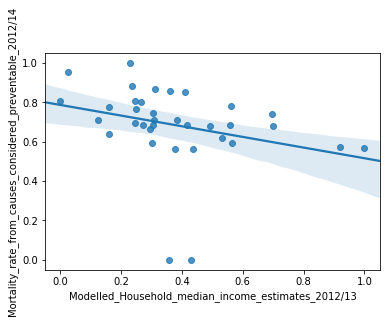

In [19]:
sns.regplot(x='Modelled_Household_median_income_estimates_2012/13', y ='Mortality_rate_from_causes_considered_preventable_2012/14', data = profiles)


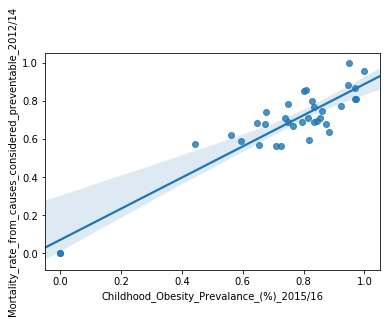

In [20]:
sns.regplot(x='Childhood_Obesity_Prevalance_(%)_2015/16', y ='Mortality_rate_from_causes_considered_preventable_2012/14', data = profiles)


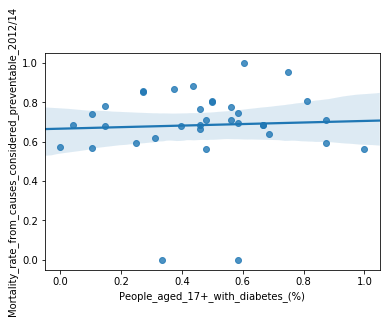

In [21]:
sns.regplot(x='People_aged_17+_with_diabetes_(%)', y ='Mortality_rate_from_causes_considered_preventable_2012/14', data = profiles)


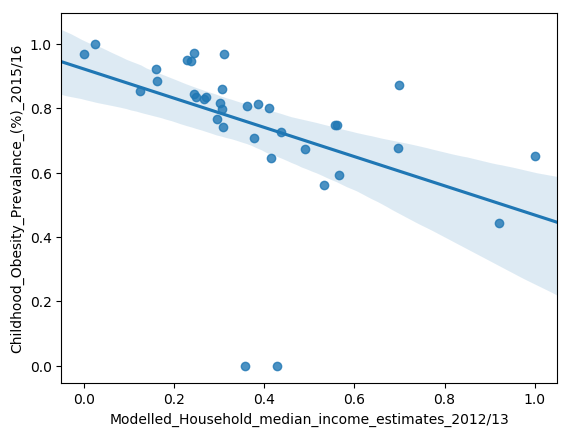

In [33]:
sns.regplot(x='Modelled_Household_median_income_estimates_2012/13', y ='Childhood_Obesity_Prevalance_(%)_2015/16', data = profiles)

In [27]:
#Creating this data subset to look closely into the three wards

areas = ['Barking and Dagenham', 'Kensington and Chelsea', 'Richmond upon Thames']
profiles3 = profiles.loc[profiles['Area_name'].isin(areas)] 
profiles3.head()

,Area_name,Population_density_(per_hectare)_2017,"Gross_Annual_Pay,_(2016)",Modelled_Household_median_income_estimates_2012/13,Childhood_Obesity_Prevalance_(%)_2015/16,People_aged_17+_with_diabetes_(%),Mortality_rate_from_causes_considered_preventable_2012/14
0,Barking and Dagenham,57.9,27886,0.023845,1.000000,0.750000,0.953975
18,Kensington and Chelsea,131.1,.,1.000000,0.652632,0.104167,0.569038
25,Richmond upon Thames,34.4,42076,0.919896,0.442105,0.000000,0.573222


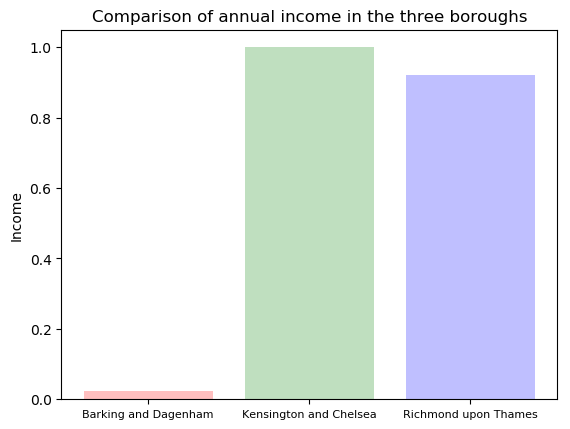

In [28]:

%matplotlib inline

import matplotlib as mpl
import matplotlib.pyplot as plt; plt.rcdefaults()
import numpy as np

areas = profiles3['Area_name'] 
y_pos = np.arange(len(areas))
income = profiles3['Modelled_Household_median_income_estimates_2012/13']

plt.bar(y_pos, income, align='center', alpha=0.25, color=['red', 'green', 'blue'])
plt.xticks(y_pos, areas, fontsize=8)
plt.ylabel('Income')
plt.title('Comparison of annual income in the three boroughs')

plt.show()

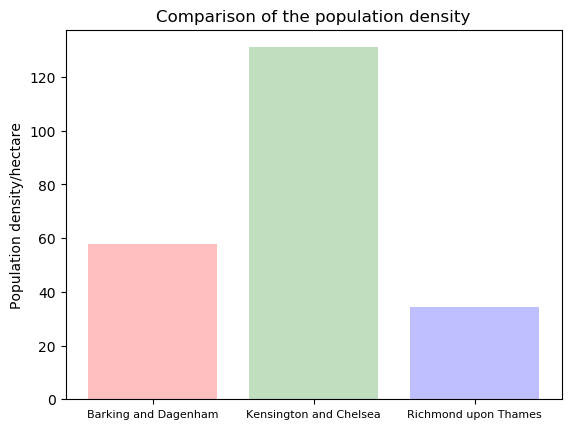

In [29]:
areas = profiles3['Area_name'] 
y_pos = np.arange(len(areas))
pop = profiles3['Population_density_(per_hectare)_2017']

plt.bar(y_pos, pop, align='center', alpha=0.25, color=['red', 'green', 'blue'])
plt.xticks(y_pos, areas, fontsize=8)
plt.ylabel('Population density/hectare')
plt.title('Comparison of the population density')

plt.show()

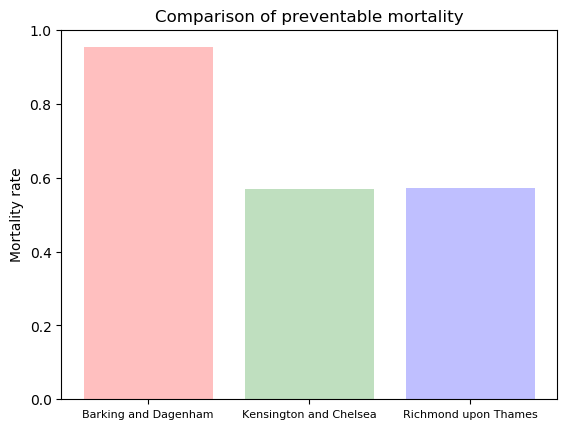

In [30]:
areas1 = profiles3['Area_name'] 
y_pos = np.arange(len(areas1))
mort = profiles3['Mortality_rate_from_causes_considered_preventable_2012/14']

plt.bar(y_pos, mort, align='center', alpha=0.25, color=['red', 'green', 'blue'])
plt.xticks(y_pos, areas1, fontsize=8)
plt.ylabel('Mortality rate')
plt.title('Comparison of preventable mortality')

plt.show()

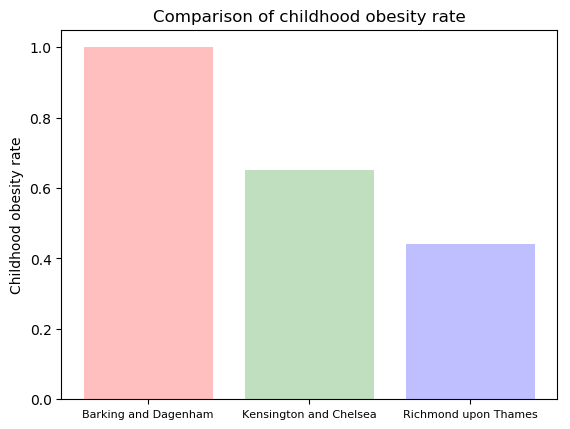

In [31]:
areas = profiles3['Area_name'] 
y_pos = np.arange(len(areas))
obesity = profiles3['Childhood_Obesity_Prevalance_(%)_2015/16']

plt.bar(y_pos, obesity, align='center', alpha=0.25, color=['red', 'green', 'blue'])
plt.xticks(y_pos, areas, fontsize=8)
plt.ylabel('Childhood obesity rate')
plt.title('Comparison of childhood obesity rate')

plt.show()

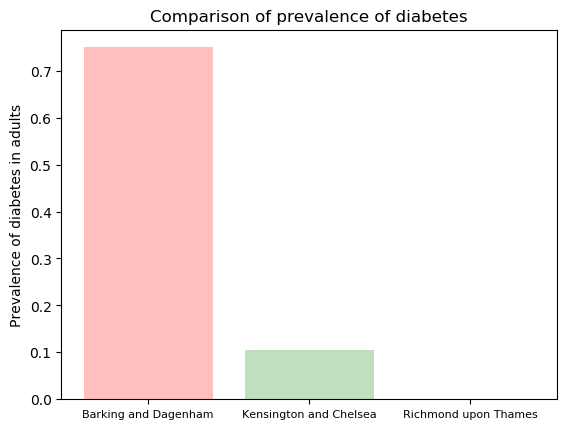

In [34]:
areas = profiles3['Area_name'] 
y_pos = np.arange(len(areas))
diabetes = profiles3['People_aged_17+_with_diabetes_(%)']

plt.bar(y_pos, diabetes, align='center', alpha=0.25, color=['red', 'green', 'blue'])
plt.xticks(y_pos, areas, fontsize=8)
plt.ylabel('Prevalence of diabetes in adults')
plt.title('Comparison of prevalence of diabetes')

plt.show()